<a href="https://colab.research.google.com/github/arokem/IntroDL/blob/master/TractSegTutorial.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup

In [0]:
#%%capture
#!pip install torch>=1.0.0  # torch already installed in colab

In [0]:
%%capture
!pip install --upgrade https://github.com/MIC-DKFZ/TractSeg/archive/master.zip

In [0]:
%%capture
!wget https://github.com/wasserth/tractseg_edu/archive/master.zip
!unzip -uo master.zip
!mv tractseg_edu-master/* .
!rm -r tractseg_edu-master

In [0]:
%matplotlib inline
import os
from img_utils import *

os.environ['TCMALLOC_LARGE_ALLOC_REPORT_THRESHOLD'] = "9073741824"

# 1. Basic usage

We uploaded an example DWI file for you. We already calculated the peaks for you using MRtrix. If you do not have the peaks calculated yet you can simply input the Diffusion image to TractSeg and pass the argument `--raw_diffusion_input`. TractSeg will call MRtrix internally to calculate the peaks for you.

In [5]:
!ls example_files

bedpostX	 Diffusion.bvecs   nodif_brain_mask.nii.gz  peaks.nii.gz
Diffusion.bvals  Diffusion.nii.gz  peak_inverted.nii.gz


When looking at the peaks using MRtrix or MITK Diffusion you will see something similar to the following:

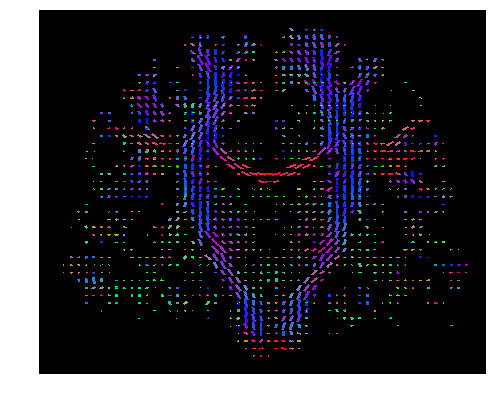

In [6]:
show_image("screenshots/peaks.png")

## Tract segmentation
Now we can call TractSeg by simply inputing the peaks and telling TractSeg to produce tract segmentations.

In [7]:
!TractSeg -i example_files/peaks.nii.gz -o output --output_type tract_segmentation

Loading weights from: /root/.tractseg/pretrained_weights_tract_segmentation_v2.npz
Processing direction (1 of 3)
100% 144/144 [00:04<00:00, 59.27it/s]
Processing direction (2 of 3)
100% 144/144 [00:02<00:00, 65.82it/s]
Processing direction (3 of 3)
100% 144/144 [00:02<00:00, 66.84it/s]


You can find the segmentations for all 72 bundles in the output directory

In [8]:
!ls output/bundle_segmentations/

AF_left.nii.gz	  IFO_right.nii.gz	ST_POSTC_left.nii.gz
AF_right.nii.gz   ILF_left.nii.gz	ST_POSTC_right.nii.gz
ATR_left.nii.gz   ILF_right.nii.gz	ST_PREC_left.nii.gz
ATR_right.nii.gz  MCP.nii.gz		ST_PREC_right.nii.gz
CA.nii.gz	  MLF_left.nii.gz	ST_PREF_left.nii.gz
CC_1.nii.gz	  MLF_right.nii.gz	ST_PREF_right.nii.gz
CC_2.nii.gz	  OR_left.nii.gz	ST_PREM_left.nii.gz
CC_3.nii.gz	  OR_right.nii.gz	ST_PREM_right.nii.gz
CC_4.nii.gz	  POPT_left.nii.gz	STR_left.nii.gz
CC_5.nii.gz	  POPT_right.nii.gz	STR_right.nii.gz
CC_6.nii.gz	  SCP_left.nii.gz	T_OCC_left.nii.gz
CC_7.nii.gz	  SCP_right.nii.gz	T_OCC_right.nii.gz
CC.nii.gz	  SLF_III_left.nii.gz	T_PAR_left.nii.gz
CG_left.nii.gz	  SLF_III_right.nii.gz	T_PAR_right.nii.gz
CG_right.nii.gz   SLF_II_left.nii.gz	T_POSTC_left.nii.gz
CST_left.nii.gz   SLF_II_right.nii.gz	T_POSTC_right.nii.gz
CST_right.nii.gz  SLF_I_left.nii.gz	T_PREC_left.nii.gz
FPT_left.nii.gz   SLF_I_right.nii.gz	T_PREC_right.nii.gz
FPT_right.nii.gz  ST_FO_left.nii.gz	T_PREF_left.nii.gz

Let's have a look at the segmentation of the CST:

In [9]:
plot_3D_volume_with_brain_mask("output/bundle_segmentations/CST_right.nii.gz",
                               "example_files/nodif_brain_mask.nii.gz")

## Start/end region segmentation

Now let us create segmentations of the start and end region of each tract by simply changing the `output_type`. Those will be used later on to remove streamlines not ending in the appropriate regions.

In [10]:
!TractSeg -i example_files/peaks.nii.gz -o output --output_type endings_segmentation

Loading weights from: /root/.tractseg/pretrained_weights_endings_segmentation_v3.npz
Processing direction (1 of 3)
100% 144/144 [00:05<00:00, 28.60it/s]
Processing direction (2 of 3)
100% 144/144 [00:02<00:00, 49.62it/s]
Processing direction (3 of 3)
100% 144/144 [00:03<00:00, 33.47it/s]
^C


In [11]:
merge_masks("output/endings_segmentations/CST_right_b.nii.gz",
            "output/endings_segmentations/CST_right_e.nii.gz",
            "output/endings_segmentations/CST_right_endings.nii.gz")
plot_3D_volume_with_brain_mask("output/endings_segmentations/CST_right_endings.nii.gz",
                               "example_files/nodif_brain_mask.nii.gz")

## Tract Orientation Mapping
Now let us also create tract orientation maps (TOMs). Those give us a peak map for each tract.

In [12]:
!TractSeg -i example_files/peaks.nii.gz -o output --output_type TOM

Loading weights from: /root/.tractseg/pretrained_weights_peak_regression_part1_v2.npz
100% 144/144 [00:04<00:00, 34.30it/s]
Loading weights from: /root/.tractseg/pretrained_weights_peak_regression_part2_v2.npz
100% 144/144 [00:02<00:00, 66.94it/s]
Loading weights from: /root/.tractseg/pretrained_weights_peak_regression_part3_v2.npz
100% 144/144 [00:02<00:00, 67.67it/s]
Loading weights from: /root/.tractseg/pretrained_weights_peak_regression_part4_v2.npz
100% 144/144 [00:02<00:00, 67.91it/s]


The Tract Orientation Map for the cortico-spinal tract (CST) looks similar to the following: 

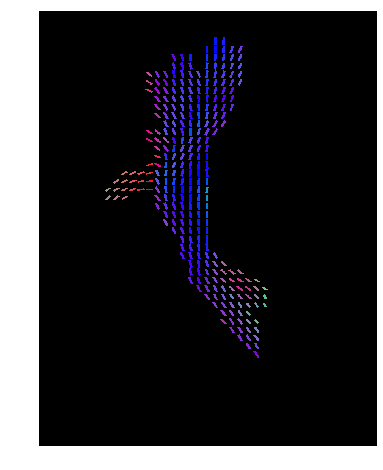

In [13]:
show_image("screenshots/TOM_CST.png")

## Tracking
Now we have everything we need to create bundle-specific tractograms. The following commands expects that a folder named `tractseg_output` (containing the previous results) exists inside of the directory specified as output. It will automatically use the tract segmentations, start/end region segmentations and the Tract Orientation Maps (TOMs) to generate bundle-specific tractograms.
It will run a tracking algorithm on the TOMs and only keep those streamlines starting and ending in the start/end regions and not leaving the tract mask.
`--test` will run the tracking for only 3 bundles to make it faster for this demonstration.
We also limit the number of streamlines to 1000 (default: 2000) to make this demonstration faster.

In [14]:
!Tracking -i examples_files/peaks.nii.gz -o output --test --nr_fibers 1000

100% 3/3 [00:45<00:00, 13.70s/it]


Let's have a look at the results:

In [15]:
plot_streamlines_with_brain_mask_and_endings_mask("output/TOM_trackings/CST_right.trk",
                                                  "example_files/nodif_brain_mask.nii.gz",
                                                  "output/endings_segmentations/CST_right_endings.nii.gz",
                                                  subsampling=1)

The `tractseg_output` folder looks the following now:

In [16]:
!ls output

bundle_segmentations  endings_segmentations  TOM  TOM_trackings


Done! That's all there is to do to create bundle-specific tractograms with TractSeg.

# 2. Preprocessing details

Before passing your image to TractSeg two things have to be considered:

1. TractSeg requires the input image to have the same orientation as MNI space. An easy way to ensure this is rigid registration to MNI space.
2. In some cases the gradients can have a flipped sign along one dimension.



## 1. Rigid registration to MNI space

TractSeg will automatically rigidly register your input to MNI space if you use the option `--preprocess` (requires FSL).
> NOTE: In this case the output of TractSeg will be in MNI space and not in subject space. You have to move it back to subject space yourself.

In [0]:
#!TractSeg -i Diffusion.nii.gz -o output --raw_diffusion_input --preprocess

## 2. Flipped peaks
Looking at the following peaks we can see that they seem to be inverted:

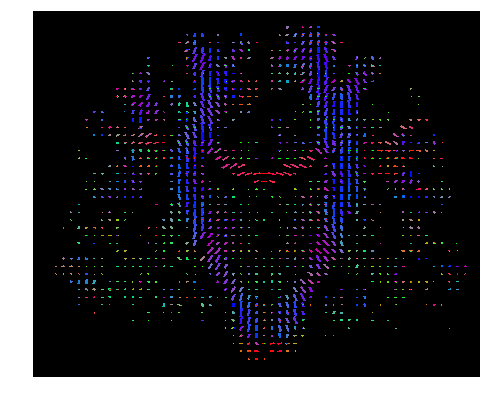

In [18]:
show_image("screenshots/peaks_inverted.png")

When flipping the sign of the x-axis they look right again. TractSeg provides a command line tool for flipping the peaks:
```
flip_peaks -i peak_inverted.nii.gz -o peaks_correct.nii.gz -a x
```

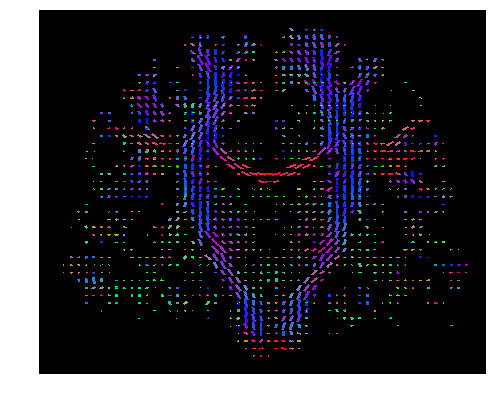

In [19]:
show_image("screenshots/peaks.png")

# Advanced settings

TractSeg offers a lot more settings. Checkout `TractSeg --help` to see all of them. Here we will mention a few of them that might be useful to a lot of people:
- super resolution
- track on best original peaks
- FACT tracking

## Super resolution

TractSeg works on an image resolution of 1.25mm. If images have lower resolution they will be upsampled to 1.25mm, then processed and then downsampled to the original resolution. But we can also tell TractSeg to skip the downsampling and return the 1.25mm output. This typically leads to higher quality output. Simply add the option `--super_resolution`.

In [0]:
!TractSeg -i example_files/peaks.nii.gz -o output_SR --output_type tract_segmentation --super_resolution

Loading weights from: /root/.tractseg/pretrained_weights_tract_segmentation_v2.npz
Processing direction (1 of 3)
 82% 118/144 [00:03<00:00, 40.62it/s]

In [0]:
show_image("screenshots/super_resolution_example.png")

## Different tracking options



### Track on best original peaks

For some applications it might be beneficial to stay closer to the original signal. Instead of tracking directly on the TOM peak we can also track on the peak from the original signal which is closest to the TOM peak. Thereby we can use the original signal, but remove the problem of crossing fibers by only keeping one peak in each voxel.

In [0]:
!Tracking -i example_files/peaks.nii.gz -o output --track_best_orig --test --nr_fibers 1000

In [0]:
plot_streamlines_with_brain_mask_and_endings_mask("output/BestOrig_trackings/CST_right.trk",
                                                  "example_files/nodif_brain_mask.nii.gz",
                                                  "output/endings_segmentations/CST_right_endings.nii.gz",
                                                  subsampling=1)

### Deterministic tracking (FACT) on TOMs
As default TractSeg is using probabilistic tracking. In some cases the user might want to use deterministic tracking. For those cases TractSeg offers the option to use FACT tracking. 

> NOTE: requires MRtrix

In [0]:
#!Tracking -i example_files/peaks.nii.gz -o output --algorithm det --tracking_dir TOM_FACT_trackings

## Use BedpostX as input (instead of MRtrix peaks)
TractSeg also works with BedpostX peaks as input. Simply input `dyads1.nii.gz` and TractSeg will automatically search for all other required files in the same directory (files needed: `dyads2_thr0.05.nii.gz`, `mean_f1samples.nii.gz`, `mean_f2samples.nii.gz`. `dyads3_thr0.05.nii.gz` and `mean_f3samples.nii.gz` are optional). This only works if the BedpostX results are not renamed.

> NOTE: At the moment MRtrix peaks work slightly better than BedpostX input, but this will be fixed in the next release. Then both will work equally well.

In [0]:
!TractSeg -i example_files/bedpostX/dyads1.nii.gz -o output_BX

In [0]:
plot_3D_volume_with_brain_mask("output_BX/bundle_segmentations/CST_right.nii.gz",
                               "example_files/nodif_brain_mask.nii.gz")

Check out `--help` for all the options:

In [0]:
!TractSeg --help